In [1]:
library(data.table)

In [2]:
library(ggplot2)
library(enrichplot)

### Load Promoter PPI network cluster information

In [3]:
ctcf_clusters <- fread('Custom_CTCF_lncap_ENCFF155SPQ_8_all-nodes_overlap-metaloop_clusters.tsv',sep='\t',header=T)
head(ctcf_clusters)

Gene,cluster,CTCF,CTCF_OR,CTCF_pv,GWAS,GWAS_OR,GWAS_pv,GWAS_Cat_prostate.carcinoma,GWAS_Cat_prostate.carcinoma_OR,GWAS_Cat_prostate.carcinoma_pv
<chr>,<int>,<chr>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
NT5C2,1,-,0.6170459,1.915757e-09,=,0.6132661,0.143359,=,0.4673163,0.1609585
SLC25A28,1,-,0.6170459,1.915757e-09,=,0.6132661,0.143359,=,0.4673163,0.1609585
NR3C2,1,-,0.6170459,1.915757e-09,=,0.6132661,0.143359,=,0.4673163,0.1609585
RDH10,1,-,0.6170459,1.915757e-09,=,0.6132661,0.143359,=,0.4673163,0.1609585
SLC9A7,1,-,0.6170459,1.915757e-09,=,0.6132661,0.143359,=,0.4673163,0.1609585
STRN3,1,-,0.6170459,1.915757e-09,=,0.6132661,0.143359,=,0.4673163,0.1609585


In [4]:
dim(ctcf_clusters)

[1] 4314   11

### Functional enrichment of promoter network genes of cluster 8 (Supplementary Table 5)

In [5]:
cluster8 <- ctcf_clusters[ctcf_clusters$cluster == 8,'Gene']
unlist(cluster8,use.names = F)

[1] "CYTH1"        "FOS"          "SLC45A1"      "NAA40"        "C16orf72"    
  [6] "CDC42BPB"     "FAM120A"      "RALY"         "ASB6"         "PRKAA1"      
 [11] "PRKD1"        "MAP3K5"       "STK40"        "MTFR1L"       "KDM2A"       
 [16] "LARP4B"       "TIMM29"       "ANXA11"       "APOO"         "CXorf58"     
 [21] "PLCB4"        "GLI3"         "USP34"        "ZCCHC2"       "SNX1"        
 [26] "HIPSTR"       "ANKRD11"      "COL11A2"      "CBX3"         "UBE3A"       
 [31] "RER1"         "MORN1"        "PEX10"        "RRNAD1"       "ISG20L2"     
 [36] "KANSL1-AS1"   "CDH1"         "CENPO"        "PTRHD1"       "MIR3190"     
 [41] "MIR3191"      "TBC1D9B"      "AUH"          "ABHD12"       "ARHGAP29"    
 [46] "PREP"         "SLC22A23"     "FBXL14"       "HDAC4"        "APOLD1"      
 [51] "CASC11"       "SOX4"         "ZBTB10"       "SARAF"        "TAF15"       
 [56] "COG7"         "IRX3"         "LOC646626"    "MIR151B"      "MIR342"      
 [61] "LOC102724190" "BTG1"         "LOC101928617" "ANK3"         "UBE2H"       
 [66] "DCTN6"        "PPP1R2"       "LINC00963"    "DDIT4"        "BCL2L1"      
 [71] "AQP3"         "UBALD2"       "LITAF"        "RBPJ"         "IDE"         
 [76] "DAPK2"        "LOC101930370" "ZADH2"        "LSM1"         "BAG4"        
 [81] "TMEM161B"     "TMEM161B-AS1" "YWHAB"        "GATAD1"       "TMEM63B"     
 [86] "MIR196A2"     "CREB3L1"      "TSPO"         "SH3D21"       "HES1"        
 [91] "MIR551A"      "NTPCR"        "CTBP1-AS"     "TNRC18"       "MYH10"       
 [96] "SLC25A25"     "SPTAN1"       "TPM1"         "CAPZB"        "PARD6G"      
[101] "NKX3-1"       "IRF2BPL"      "OTULIN"       "ERLIN2"       "STOM"        
[106] "ADNP"         "NFKBIA"       "CASZ1"        "TBC1D2"       "R3HDM2"      
[111] "TAOK3"        "CCDC85C"      "HHIPL1"       "CSNK1A1"      "AHCYL1"      
[116] "EIF2S2"       "DLGAP1-AS1"   "WNT7B"        "PRMT2"        "SH2D4A"      
[121] "LOC100130872" "LOC105376671" "IQCE"         "MIR1204"      "PYURF"       
[126] "LOC101929134" "UCK1"         "ORAOV1"       "DNAAF5"       "DNAJC5B"     
[131] "TPRG1-AS1"    "NFIL3"        "MARC1"        "GEMIN8"       "ELDR"        
[136] "C4orf36"      "HOMER1"       "ENOX1"        "ATPAF2"       "WWP1"        
[141] "ENO1"         "CCND3"        "SECISBP2"     "LOC105377348" "SBF2"        
[146] "ATIC"         "NAA38"        "KLF11"        "LOC101929882" "COPRS"       
[151] "RAC3"         "SORD"         "RASSF3"       "TTBK2"        "B3GNTL1"     
[156] "DEGS2"        "LOC101928111" "CIPC"         "ANKRD12"      "NDUFV2-AS1"  
[161] "STK24"        "MBP"          "FAM35A"       "GLUD1"        "BRD9"        
[166] "TRIP13"       "PRKAR1B"      "SLC7A5"       "TBC1D16"      "OGFR"        
[171] "XKR9"         "SGMS1-AS1"    "PYCR2"        "DHRS12"       "MGME1"       
[176] "SNX5"         "GDI2"         "GSE1"         "CHSY1"        "MIIP"        
[181] "SCMH1"        "MRPL14"       "EPB41L4B"     "MIR4492"      "EIF4EBP1"    
[186] "MATR3"        "HIVEP2"       "JADE2"        "VDAC2"        "BRCA2"       
[191] "ACTG1"        "PRDM15"       "CD164"        "PDCD5"        "PACSIN2"     
[196] "PDE10A"       "SEC11C"       "CEBPD"        "CTBP2"        "ENO1-AS1"    
[201] "FOXP1"        "GATA2-AS1"    "CRNDE"        "KLF3"         "APBB2"       
[206] "CDKN1B"       "JARID2-AS1"   "GATA2"        "PPP2R2A"      "FLJ37035"    
[211] "EDRF1"        "KDM6A"        "USP39"        "TMEM150A"     "STAG1"       
[216] "SUDS3"        "ZMIZ1-AS1"    "PVT1"         "ZFP36L1"      "PPP1CB"      
[221] "RFFL"         "PHF12"        "SAMD8"        "SHB"          "LINC01569"   
[226] "HOXC-AS2"     "SPG7"         "KCNMA1"       "ZNF703"       "KLF3-AS1"    
[231] "BAHCC1"       "BCL9L"        "FLNA"         "LMAN1"        "YY1"         
[236] "HMGXB3"       "GTPBP4"       "ARL5B"        "IFT43"        "MYL12A"      
[241] "GULP1"        "FOSL2"        "CEP63"        "ANAPC13"      "PDHX"        
[246] "APIP"         "CBLL1"     

In [6]:
library(gprofiler2)

### g:Profiler2 query

In [7]:
Sys.time()

[1] "2023-05-31 18:08:43 CEST"

In [8]:
table_s5 <- gprofiler2::gost(query = unlist(cluster8,use.names = F),
                             organism = 'hsapiens',
                             ordered_query = F,
                             significant = T,
                             evcodes=T,
                             user_threshold = 0.05,
                             correction_method = "fdr",
                             domain_scope = 'custom',
                             custom_bg = ctcf_clusters$Gene # Background is the 4314 gene promoters
                            )

In [9]:
Sys.time()

[1] "2023-05-31 18:08:48 CEST"

### Supplementary Table 5 Preview

In [10]:
head(table_s5$result)

,query,significant,p_value,term_size,query_size,intersection_size,precision,recall,term_id,source,term_name,effective_domain_size,source_order,parents,evidence_codes,intersection
,<chr>,<lgl>,<dbl>,<int>,<int>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<int>,<int>,<list>,<chr>,<chr>
1,query_1,TRUE,0.002897675,194,251,31,0.12350598,0.1597938,GO:0051093,GO:BP,negative regulation of developmental process,4019,14248,GO:00325....,"ISS IEA,IEA,IEA,IMP IEA,IEA,IEA,IEA,IEA,IGI,IEA,IMP ISS IBA IEA,ISS IEA,IMP IEA,IEA,NAS,ISS IEA,IMP IEA,NAS IEA,IDA,IEA,IEA,ISS IEA,IEA,ISS,ISS IEA,IDA,IMP,IEA,IDA ISS IEA,IEA,IMP","GLI3,UBE3A,CDH1,HDAC4,IRX3,BCL2L1,RBPJ,LSM1,CREB3L1,TSPO,HES1,NKX3-1,NFKBIA,MBP,BRD9,CDKN1B,GATA2,SUDS3,ZFP36L1,SHB,YY1,LAG3,CCND1,ID2,ZBTB7B,ZFHX3,MYC,STC2,MAFB,PPP3CA,FOXA1"
2,query_1,TRUE,0.003353738,301,251,38,0.15139442,0.1262458,GO:1902679,GO:BP,negative regulation of RNA biosynthetic process,4019,23481,GO:00105....,"IMP,IDA IEA,IDA IMP IBA IEA,IDA IMP IGI IBA IEA,ISS,ISS IEA,IDA IMP ISS IEA,IDA IEA,IDA IEA,IDA IMP IEA,IDA,IDA,IDA IMP ISS IEA,ISS IEA,IDA IMP,IEA,IDA TAS IEA,ISS IBA IEA,IBA NAS,IEA,ISS TAS IEA,IEA,IDA,IDA,IBA IEA,IMP ISS IBA NAS,IDA IBA IEA,IMP IBA IEA,IDA,IDA IEA,IDA IEA,IDA ISS IBA IEA,IEA,IDA,IDA IMP,IDA IEA,NAS,IEA","KDM2A,GLI3,CBX3,HDAC4,ZBTB10,IRX3,RBPJ,CREB3L1,HES1,NKX3-1,IRF2BPL,PRMT2,NFIL3,WWP1,ENO1,CCND3,KLF11,CIPC,SCMH1,CEBPD,CTBP2,KLF3,APBB2,CDKN1B,GATA2,SUDS3,PHF12,ZNF703,FLNA,YY1,CCND1,ID2,ZBTB7B,ZFHX3,MYC,HIVEP1,MAFB,FOXA1"
3,query_1,TRUE,0.003353738,358,251,43,0.17131474,0.1201117,GO:1901700,GO:BP,response to oxygen-containing compound,4019,22661,GO:0042221,"IDA IMP IEA,ISS IEA,IMP,IDA IEA,IDA,IDA IEA,IDA,ISS IEA,IEA,IEA,IEA,IEA,IDA TAS,IEA,NAS,IEA,IEA,IEP,ISS IEA,IEA,IEA,IDA,IEP,IDA IEA,IEA,IEA,IDA,IEA,IEA,IMP,IEA,IEA,IDA IEA,IDA ISS IEA,IDA IMP,IDA,IMP,IMP,IEA,ISS IEA,IEA,IDA IEA,IDA","FOS,PRKAA1,PRKD1,MAP3K5,ANXA11,UBE3A,CDH1,SOX4,MIR342,BTG1,DDIT4,BCL2L1,AQP3,LITAF,IDE,TSPO,HES1,TPM1,NKX3-1,ADNP,NFKBIA,AHCYL1,WNT7B,HOMER1,CCND3,KLF11,STK24,MBP,SLC7A5,SNX5,ACTG1,KLF3,CDKN1B,ZFP36L1,KCNMA1,ZNF703,FLNA,ERCC6L2,CCND1,ZBTB7B,STC2,PPP3CA,FOXA1"
4,query_1,TRUE,0.003353738,15,251,7,0.02788845,0.4666667,GO:0060993,GO:BP,kidney morphogenesis,4019,15989,GO:00018....,"IEA,ISS IEA,IEA,IEA,ISS,ISS,ISS IEA","GLI3,SOX4,IRX3,HES1,WNT7B,MYC,PPP3CA"
5,query_1,TRUE,0.003353738,31,251,10,0.03984064,0.3225806,GO:0051592,GO:BP,response to calcium ion,4019,14597,GO:00100....,"IEA,ISS IEA,IDA,TAS,IDA,IDA,IEA,IDA,IEA,IDA","FOS,PRKAA1,ANXA11,AQP3,AHCYL1,HOMER1,ACTG1,KCNMA1,CCND1,PPP3CA"
6,query_1,TRUE,0.003353738,323,251,41,0.16334661,0.1269350,GO:0051253,GO:BP,negative regulation of RNA metabolic process,4019,14369,GO:00106....,"IMP,IMP,IDA IEA,IDA IMP IBA IEA,IDA IMP IGI IBA IEA,ISS,IDA,ISS IEA,IDA IMP ISS IEA,IDA IEA,IDA IEA,IDA IMP IEA,IDA,IDA,IDA IMP ISS IEA,ISS IEA,IDA IMP,IEA,IEA,IDA TAS IEA,ISS IBA IEA,IBA NAS,IEA,ISS TAS IEA,IEA,IDA,IDA,IBA IEA,IMP ISS IBA NAS,IDA IBA IEA,IMP IBA IEA,IDA,IDA IEA,IDA IEA,IDA ISS IBA IEA,IEA,IDA,IDA IMP,IDA IEA,NAS,IEA","KDM2A,LARP4B,GLI3,CBX3,HDAC4,ZBTB10,TAF15,IRX3,RBPJ,CREB3L1,HES1,NKX3-1,IRF2BPL,PRMT2,NFIL3,WWP1,ENO1,CCND3,SECISBP2,KLF11,CIPC,SCMH1,CEBPD,CTBP2,KLF3,APBB2,CDKN1B,GATA2,SUDS3,PHF12,ZNF703,FLNA,YY1,CCND1,ID2,ZBTB7B,ZFHX3,MYC,HIVEP1,MAFB,FOXA1"


In [11]:
table_s5$meta

,gene_id,description,number_of_go_annotations
,<chr>,<chr>,<int>
1,ENSG00000015479,matrin 3 [Source:HGNC Symbol;Acc:HGNC:6912],101
2,ENSG00000280987,matrin 3 [Source:NCBI gene (formerly Entrezgene);Acc:9782],19
,gene_id,description,number_of_go_annotations
,<chr>,<chr>,<int>
1,ENSG00000114861,forkhead box P1 [Source:HGNC Symbol;Acc:HGNC:3823],429
2,ENSG00000285708,novel protein,65


### Supplementary Table 5 query g:Profiler Plot

In [12]:
plot_st5 <- gostplot(table_s5,interactive=T)

plot_st5

HTML widgets cannot be represented in plain text (need html)

### dotplot (with g:Profiler2 enrichments)

In [13]:
library(enrichplot)

Warning message in order(as.numeric(unique(result$Cluster))):
“NAs introduced by coercion”


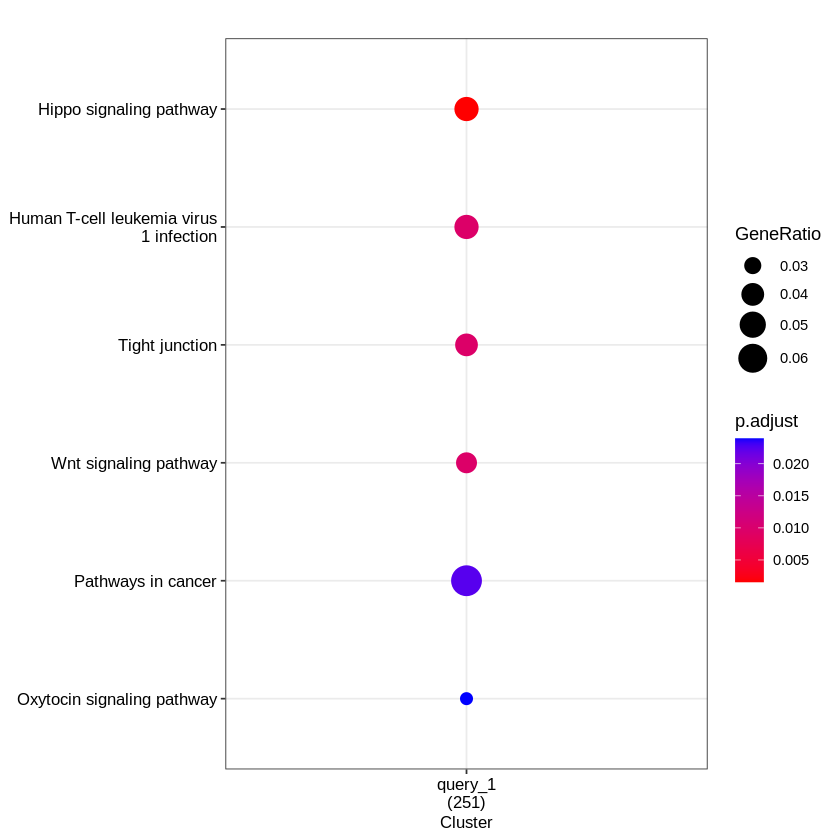

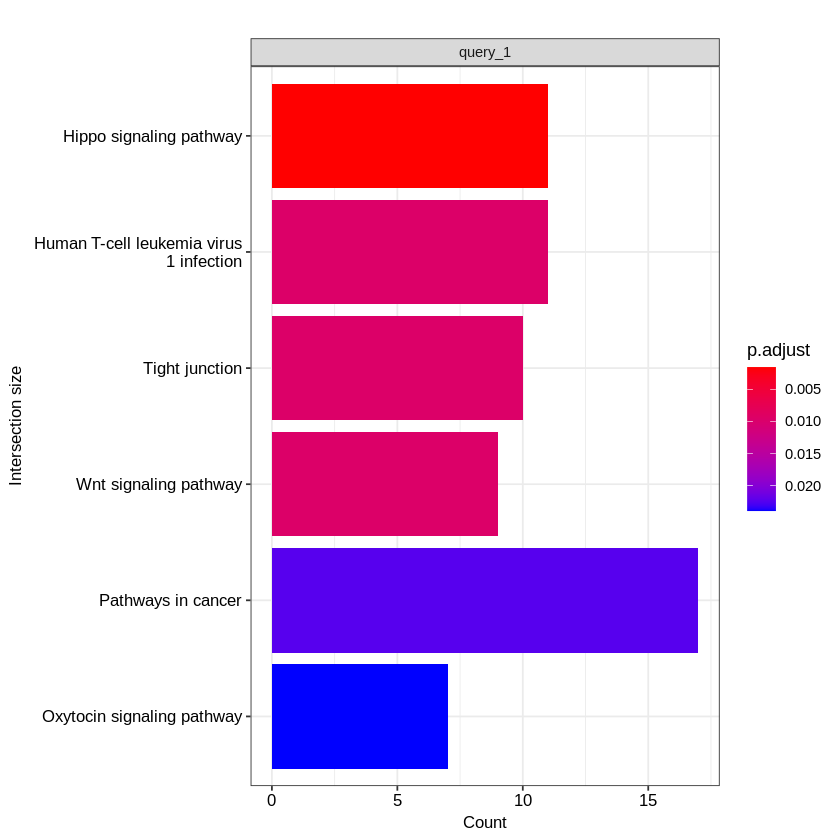

In [14]:
gp_mod = table_s5$result[table_s5$result[,'source']=='KEGG',c("query", "source", "term_id",
                                "term_name", "p_value", "query_size", 
                                "intersection_size", "term_size", 
                                "effective_domain_size", "intersection")]

gp_mod$GeneRatio = paste0(gp_mod$intersection_size,  "/", gp_mod$query_size)
gp_mod$BgRatio = paste0(gp_mod$term_size, "/", gp_mod$effective_domain_size)
names(gp_mod) = c("Cluster", "Category", "ID", "Description", "p.adjust", 
                    "query_size", "Count", "term_size", "effective_domain_size", 
                    "geneID", "GeneRatio", "BgRatio")
gp_mod$geneID = gsub(",", "/", gp_mod$geneID)
row.names(gp_mod) = gp_mod$ID

gp_mod_cluster = new("compareClusterResult", compareClusterResult = gp_mod)
gp_mod_enrich  = new("enrichResult", result = gp_mod)

enrichplot::dotplot(gp_mod_cluster,showCategory=50,font.size=10)

ggsave("dotplot_tableS5.svg", width = 20, height = 18, units = "cm")

barplot(gp_mod_enrich, showCategory = 50, font.size = 10) + 
  ggplot2::facet_grid(~Cluster) +
  ggplot2::ylab("Intersection size")

ggsave("barplot_tableS5.svg", width = 20, height = 18, units = "cm")

### Save Supplementary Table 5

In [15]:
write.table(as.matrix(table_s5$result),file = 'table_s5.tsv',sep='\t',col.names = T,row.names = F,quote = T)

### Functional Enrichment of all intermediate proteins (Supplementary Table 7)

#### Load Intermediate Protein universe

In [16]:
intermediate_uni <- unlist(read.table(file = 'intermediate_universe.txt'),use.names = F)
intermediate_uni

[1] "TP53"       "CREBBP"     "EP300"      "PPARG"      "HDAC2"     
  [6] "AURKA"      "CTBP1"      "RARA"       "UBE2I"      "IKBKB"     
 [11] "MYC"        "RELA"       "SMAD4"      "HDAC1"      "AR"        
 [16] "HDAC3"      "RFWD2"      "APP"        "ARL6IP4"    "SMAD3"     
 [21] "JUN"        "APLP2"      "ARID4B"     "MAPK1"      "RBBP6"     
 [26] "MAPK9"      "MAPK8"      "MAPK10"     "CDK6"       "SUMO1"     
 [31] "PRKAA2"     "RB1"        "MAX"        "NPM1"       "HCFC1"     
 [36] "SKP2"       "SMAD2"      "NCOA3"      "KAT2B"      "BPTF"      
 [41] "KEAP1"      "HMGA1"      "PIAS1"      "NCOR2"      "SET"       
 [46] "RXRA"       "BAP1"       "NCOR1"      "BRCA1"      "STAT3"     
 [51] "SIN3A"      "NFATC2"     "NFATC1"     "CTNNB1"     "MDM2"      
 [56] "KDM2A"      "NFIX"       "TBP"        "SMARCA4"    "MBD1"      
 [61] "SATB2"      "ZBTB10"     "USP47"      "PSIP1"      "SMARCA1"   
 [66] "CUX1"       "KDM5A"      "TFAP4"      "SMARCA5"    "H2AFY"     
 [71] "CHD4"       "HOXB9"      "CDC27"      "NACC1"      "NFIC"      
 [76] "PBX1"       "RECQL"      "RCC1"       "RPA2"       "ATXN1"     
 [81] "KDM1A"      "PATZ1"      "SMARCC2"    "SMARCE1"    "PLK1"      
 [86] "BTRC"       "PSMC5"      "PRKCD"      "NFYC"       "NUP62"     
 [91] "HSP90AA1"   "PGR"        "BCL11B"     "SIRT1"      "RUNX2"     
 [96] "SMURF1"     "CARM1"      "SF3B1"      "CSNK2A1"    "CLU"       
[101] "TBK1"       "EIF1AD"     "PNKP"       "PIN1"       "BCL3"      
[106] "HSP90AB1"   "MEN1"       "COPS5"      "CHUK"       "BIRC3"     
[111] "YBX1"       "SMC1A"      "XPO1"       "TRRAP"      "RBL2"      
[116] "USP11"      "KAT5"       "LRIF1"      "VHL"        "CITED2"    
[121] "CHD8"       "CHD3"       "BCL6"       "FOXJ2"      "CEP70"     
[126] "DAXX"       "MEIS1"      "XRCC5"      "CRK"        "MAPK3"     
[131] "YY1"        "XRCC6"      "ATR"        "MAPK14"     "FOS"       
[136] "KDM5B"      "REL"        "CEBPB"      "CEBPG"      "CEBPA"     
[141] "GSK3B"      "FBXW7"      "FHL2"       "BACH1"      "POU2F1"    
[146] "JUND"       "FOSL2"      "JUNB"       "SREBF2"     "HSPB1"     
[151] "NFIA"       "MECP2"      "CREM"       "EHMT2"      "FHL3"      
[156] "PML"        "NFYA"       "TPI1"       "PPIG"       "POGZ"      
[161] "ATF7IP"     "TLE1"       "FANCL"      "CBX5"       "PHB"       
[166] "FOXK2"      "ATP5O"      "EAF1"       "SDCBP"      "TRIP4"     
[171] "RUVBL2"     "NR3C1"      "POLR2A"     "HUWE1"      "MED1"      
[176] "PRKDC"      "UBA52"      "OTUB1"      "ZBTB17"     "PARP1"     
[181] "BANP"       "L3MBTL1"    "APPL1"      "PRKAB2"     "CDK2"      
[186] "MED6"       "MED23"      "HIF1A"      "PSME3"      "GTF2H1"    
[191] "MDM4"       "STAT1"      "MAD2L1BP"   "RPS7"       "TSC22D3"   
[196] "RPS3"       "CDK9"       "NFKBIA"     "TFDP1"      "COPS6"     
[201] "MAPK7"      "PSEN1"      "NFE2L2"     "NOTCH1"     "GTF3C5"    
[206] "CTBP2"      "MEF2D"      "RNPS1"      "HDAC5"      "ABL1"      
[211] "TADA3"      "CCNA2"      "TFAP2A"     "EPAS1"      "NFKB1"     
[216] "MEF2C"      "NRF1"       "PSMA3"      "RXRB"       "LCOR"      
[221] "TDG"        "SRC"        "NCOA1"      "TWIST1"     "SETD7"     
[226] "GNL3"       "MTOR"       "BHLHE40"    "ATF3"       "TRIM28"    
[231] "APEX1"      "HSP90B1"    "NLK"        "PTK2"       "CDKN1A"    
[236] "CTR9"       "SIAH1"      "PDGFRB"     "GADD45GIP1" "HIC1"      
[241] "AKT1"       "ATM"        "PSMD11"     "FBXW11"     "IKBKE"     
[246] "NSD1"       "NCOA2"      "CCNH"       "UBE3A"      "USP7"      
[251] "BAG1"       "ZBTB16"     "NCOA6"      "ZMIZ1"      "SMARCD1"   
[256] "STUB1"      "CDK7"       "ZBTB7A"     "ETS1"       "PIAS2"     
[261] "USP10"      "RANBP9"     "RCHY1"      "TAF1"       "SMARCC1"   
[266] "KAT7"       "ERCC3"      "TRIM24"     "PTEN"       "JMJD1C"    
[271] "SART3"      "TMF1"       "FKBP4"      "AES"        "MBD2"      
[276] "SMAD1"      "E2F1"       "BCOR"       "RBM48"      "MAFB"      
[281] "ESR2"       "GTF2I"

In [17]:
length(intermediate_uni)

[1] 751

In [18]:
table_s7 <- gprofiler2::gost(query = intermediate_uni,
                             organism = 'hsapiens',
                             ordered_query = F,
                             significant = T,
                             evcodes=T,
                             user_threshold = 0.05,
                             correction_method = "fdr",
                             domain_scope = 'annotated') #Only annotated genes as background

In [19]:
head(table_s7$result)

,query,significant,p_value,term_size,query_size,intersection_size,precision,recall,term_id,source,term_name,effective_domain_size,source_order,parents,evidence_codes,intersection
,<chr>,<lgl>,<dbl>,<int>,<int>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<int>,<int>,<list>,<chr>,<chr>
1,query_1,TRUE,3.535790e-05,10,436,9,0.02064220,0.9000000,CORUM:149,CORUM,PBAF complex (Polybromo- and BAF containing complex),3383,74,CORUM:00....,"CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM","SMARCA4,SMARCC2,SMARCE1,SMARCD1,SMARCC1,ACTL6A,SMARCB1,ACTB,ARID2"
2,query_1,TRUE,3.535790e-05,10,436,9,0.02064220,0.9000000,CORUM:2829,CORUM,RSmad complex,3383,1229,CORUM:00....,"CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM","CREBBP,SMAD4,SMAD3,SMAD2,NCOA3,SMARCA4,SMARCC2,SMARCC1,TRIM33"
3,query_1,TRUE,3.535790e-05,28,436,16,0.03669725,0.5714286,CORUM:1257,CORUM,ALL-1 supercomplex,3383,714,CORUM:00....,"CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM","HDAC2,HDAC1,SIN3A,TBP,SMARCA5,KDM1A,SMARCC2,CHD3,TAF1,SMARCC1,WDR5,SMARCB1,TAF12,EFTUD2,SMARCA2,SAP30"
4,query_1,TRUE,4.294532e-05,13,436,10,0.02293578,0.7692308,CORUM:287,CORUM,ARC-L complex,3383,169,CORUM:00....,"CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM","MED1,MED6,MED23,MED12,MED14,MED25,CDK8,MED17,MED15,MED13"
5,query_1,TRUE,4.294532e-05,13,436,10,0.02293578,0.7692308,CORUM:909,CORUM,ARC92-Mediator complex,3383,506,CORUM:00....,"CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM","MED1,MED6,MED23,MED12,MED14,MED25,CDK8,MED17,MED15,MED13"
6,query_1,TRUE,4.294532e-05,13,436,10,0.02293578,0.7692308,CORUM:1230,CORUM,WINAC complex,3383,697,CORUM:00....,"CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM,CORUM","SMARCA4,SMARCC2,SMARCE1,SMARCD1,SMARCC1,TOP2B,ACTL6A,SMARCB1,CHAF1A,SMARCA2"


In [20]:
table_s7$result[5621,]

,query,significant,p_value,term_size,query_size,intersection_size,precision,recall,term_id,source,term_name,effective_domain_size,source_order,parents,evidence_codes,intersection
,<chr>,<lgl>,<dbl>,<int>,<int>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<int>,<int>,<list>,<chr>,<chr>
5621,query_1,TRUE,3.615137e-24,97,477,41,0.08595388,0.4226804,KEGG:05215,KEGG,Prostate cancer,8161,459,KEGG:00000,"KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG,KEGG","TP53,CREBBP,EP300,IKBKB,RELA,AR,MAPK1,RB1,CTNNB1,MDM2,HSP90AA1,HSP90AB1,CHUK,MAPK3,GSK3B,CDK2,NFKBIA,NFKB1,MTOR,HSP90B1,CDKN1A,PDGFRB,AKT1,PTEN,E2F1,EGFR,PIK3R1,GRB2,CCND1,CREB1,IKBKG,E2F3,CDKN1B,MAP2K1,ATF4,CREB5,LEF1,TCF7L2,BCL2,CREB3,FOXO1"


### Dotplot

Warning message in order(as.numeric(unique(result$Cluster))):
“NAs introduced by coercion”


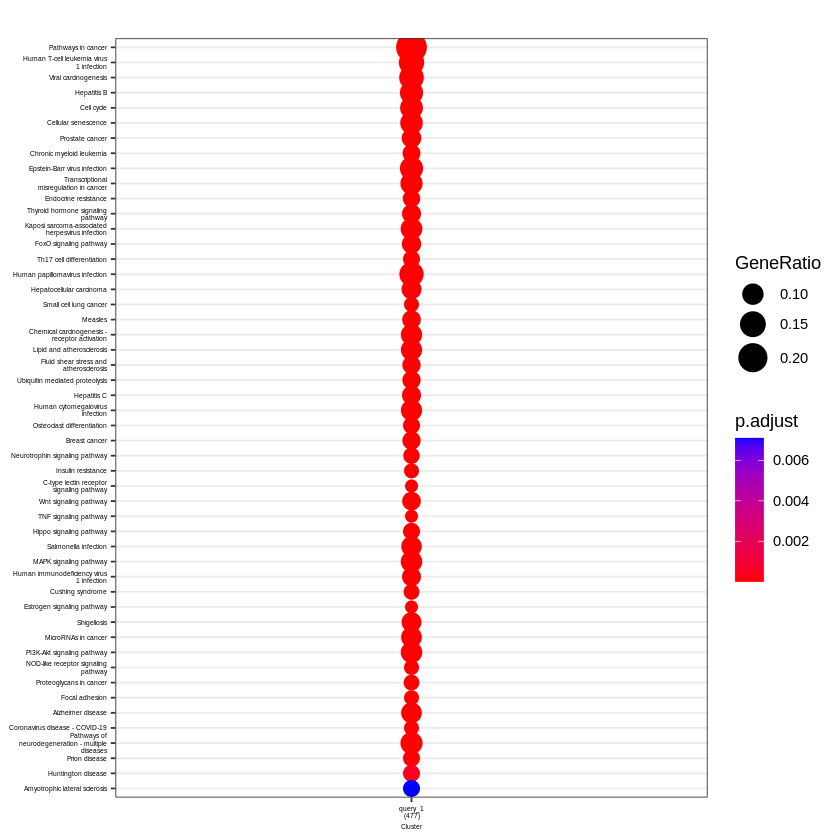

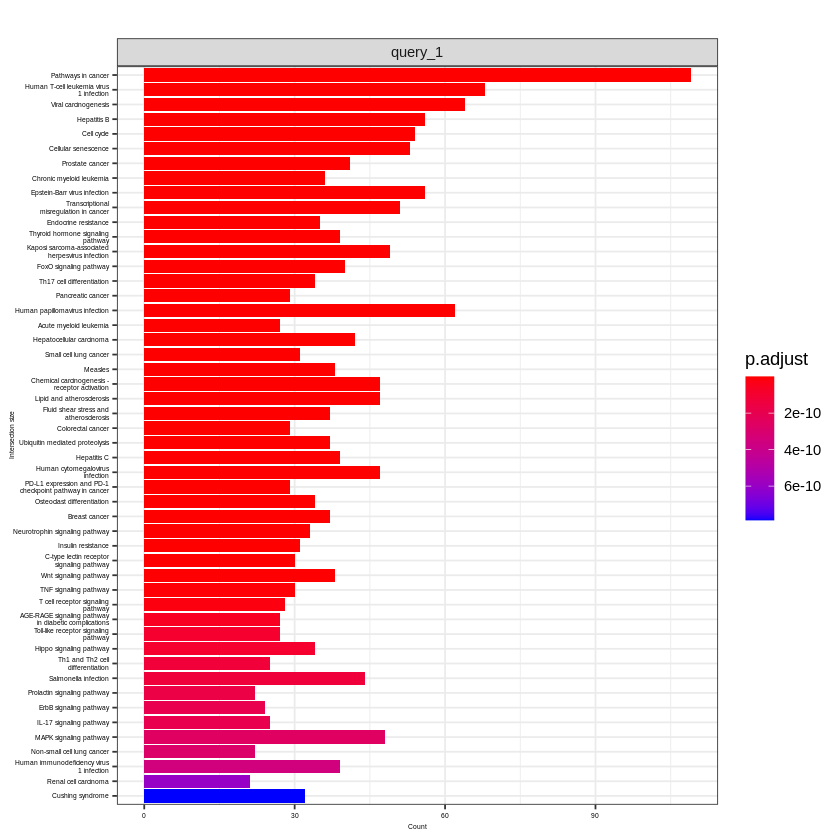

In [21]:
gp_mod = table_s7$result[table_s7$result[,'source']=='KEGG',c("query", "source", "term_id",
                                "term_name", "p_value", "query_size", 
                                "intersection_size", "term_size", 
                                "effective_domain_size", "intersection")]

gp_mod$GeneRatio = paste0(gp_mod$intersection_size,  "/", gp_mod$query_size)
gp_mod$BgRatio = paste0(gp_mod$term_size, "/", gp_mod$effective_domain_size)
names(gp_mod) = c("Cluster", "Category", "ID", "Description", "p.adjust", 
                    "query_size", "Count", "term_size", "effective_domain_size", 
                    "geneID", "GeneRatio", "BgRatio")
gp_mod$geneID = gsub(",", "/", gp_mod$geneID)
row.names(gp_mod) = gp_mod$ID

gp_mod_cluster = new("compareClusterResult", compareClusterResult = gp_mod)
gp_mod_enrich  = new("enrichResult", result = gp_mod)

enrichplot::dotplot(gp_mod_cluster,showCategory=50,font.size=4)

ggsave("dotplot_tableS7.svg", width = 20, height = 18, units = "cm")

barplot(gp_mod_enrich, showCategory = 50, font.size = 4) + 
  ggplot2::facet_grid(~Cluster) +
  ggplot2::ylab("Intersection size")

ggsave("barplot_tableS7.svg", width = 20, height = 18, units = "cm")

### Save Supplementary Table 7

In [22]:
write.table(as.matrix(table_s7$result),file = 'table_s7.tsv',sep='\t',col.names = T,row.names = F,quote = T)

### Supplementary Table 7 query g:Profiler plot

In [23]:
plot_st7 <- gostplot(table_s7,interactive=T)

plot_st7

HTML widgets cannot be represented in plain text (need html)

### Functional Enrichment Analysis of Significantly central proteins of Cluster 8

#### Load Significantly central proteins from Cluster 8

In [24]:
cluster_8_centrality <- read.table('significant_proteins_cluster_8.txt',sep='\t',header=T)

In [25]:
cluster_8_centrality

all_genes,mean_bet_in,mean_bet_out,ratio_bet,mean_deg_in,mean_deg_out,ratio_deg,pvalue_ratio,pvalue_degree
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AURKA,0.003372864,0.002849042,1.183859,0.02786631,0.02155054,1.293068,0.015,0.000
BTRC,0.007071382,0.006070430,1.164890,0.03925899,0.02986878,1.314382,0.013,0.000
CDK6,0.008811500,0.007278274,1.210658,0.02514982,0.02038969,1.233458,0.002,0.000
CREBBP,0.032670593,0.027991785,1.167149,0.11020206,0.07916791,1.392004,0.000,0.000
CTNNB1,0.010547503,0.009057942,1.164448,0.04388062,0.03255127,1.348047,0.003,0.000
EP300,0.112052889,0.101110451,1.108223,0.20497449,0.14905268,1.375182,0.000,0.000
FOS,0.009563349,0.007460114,1.281931,0.03634933,0.02720345,1.336203,0.000,0.000
GSK3B,0.017790320,0.012890348,1.380127,0.04087137,0.02887936,1.415245,0.000,0.000
HDAC2,0.025215652,0.022859484,1.103072,0.07854754,0.05846918,1.343401,0.005,0.000


### Filter to betweeneess + degree p-value < 0.01

In [26]:
sign_central <- cluster_8_centrality[cluster_8_centrality$pvalue_ratio < 0.01 & cluster_8_centrality$pvalue_degree < 0.01, ]$all_genes

In [27]:
sign_central <- sign_central[-4] #WE FILTER EP300 AS THE PRESENCE OF THE NODE WAS NOT ENRICHED.
sign_central

[1] "CDK6"   "CREBBP" "CTNNB1" "FOS"    "GSK3B"  "HDAC2"  "HDAC3"  "HIF1A" 
 [9] "JUND"   "KAT5"   "MAPK1"  "MAPK3"  "MAPK8"  "NCOR2"  "PGR"    "PIAS1" 
[17] "SMAD2"  "SMAD4"  "UBA52"  "UBE2I"  "XRCC5"  "XRCC6"

In [28]:
table_s9 <- gprofiler2::gost(query = sign_central,
                             organism = 'hsapiens',
                             ordered_query = F,
                             significant = T,
                             evcodes=T,
                             user_threshold = 0.05,
                             correction_method = "fdr",
                             domain_scope = 'custom',
                             custom_bg = intermediate_uni) 
#Only intermediate universe as background

In [29]:
head(table_s9)

query,significant,p_value,term_size,query_size,intersection_size,precision,recall,term_id,source,term_name,effective_domain_size,source_order,parents,evidence_codes,intersection
<chr>,<lgl>,<dbl>,<int>,<int>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<int>,<int>,<list>,<chr>,<chr>
query_1,TRUE,4.733830e-03,3,22,3,0.13636364,1.00000000,CORUM:3753,CORUM,CREBBP-SMAD2-SMAD4 pentameric complex,752,1509,CORUM:00....,"CORUM,CORUM,CORUM","CREBBP,SMAD2,SMAD4"
query_1,TRUE,1.972429e-02,2,22,2,0.09090909,1.00000000,CORUM:3749,CORUM,CREBBP-SMAD2 hexameric complex,752,1507,CORUM:00....,"CORUM,CORUM","CREBBP,SMAD2"
query_1,TRUE,1.972429e-02,2,22,2,0.09090909,1.00000000,CORUM:5264,CORUM,TCF4-CTNNB1-CREBBP complex,752,1617,CORUM:00....,"CORUM,CORUM","CREBBP,CTNNB1"
query_1,TRUE,1.972429e-02,2,22,2,0.09090909,1.00000000,CORUM:3038,CORUM,SMAD2-SMAD4-FAST1 complex,752,1348,CORUM:00....,"CORUM,CORUM","SMAD2,SMAD4"
query_1,TRUE,1.972429e-02,7,22,3,0.13636364,0.42857143,CORUM:1505,CORUM,NCOR2 complex,752,767,CORUM:00....,"CORUM,CORUM,CORUM","HDAC2,HDAC3,NCOR2"
query_1,TRUE,1.972429e-02,2,22,2,0.09090909,1.00000000,CORUM:1188,CORUM,SMRT core complex,752,665,CORUM:00....,"CORUM,CORUM","HDAC3,NCOR2"
query_1,TRUE,1.972429e-02,2,22,2,0.09090909,1.00000000,CORUM:752,CORUM,SMRT core complex,752,416,CORUM:00....,"CORUM,CORUM","HDAC3,NCOR2"
query_1,TRUE,1.972429e-02,2,22,2,0.09090909,1.00000000,CORUM:3233,CORUM,"SMAD2-SMAD4-FAST1-TGIF complex, TGF(beta) induced",752,1473,CORUM:00....,"CORUM,CORUM","SMAD2,SMAD4"
query_1,TRUE,1.972429e-02,2,22,2,0.09090909,1.00000000,CORUM:3739,CORUM,SKI-SMAD2-SMAD4 pentameric complex,752,1505,CORUM:00....,"CORUM,CORUM","SMAD2,SMAD4"


### Supplementary Table 9 query g:Profiler plot

In [30]:
plot_st9 <- gostplot(table_s9,interactive=T)

plot_st9

HTML widgets cannot be represented in plain text (need html)

### KEGG terms Dotplot

Warning message in order(as.numeric(unique(result$Cluster))):
“NAs introduced by coercion”


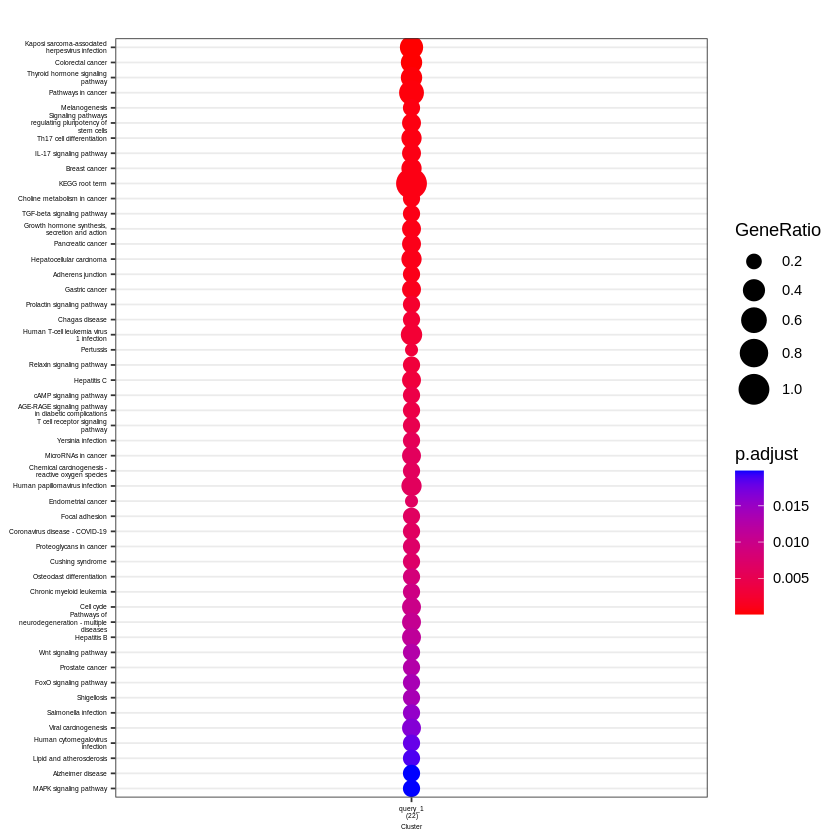

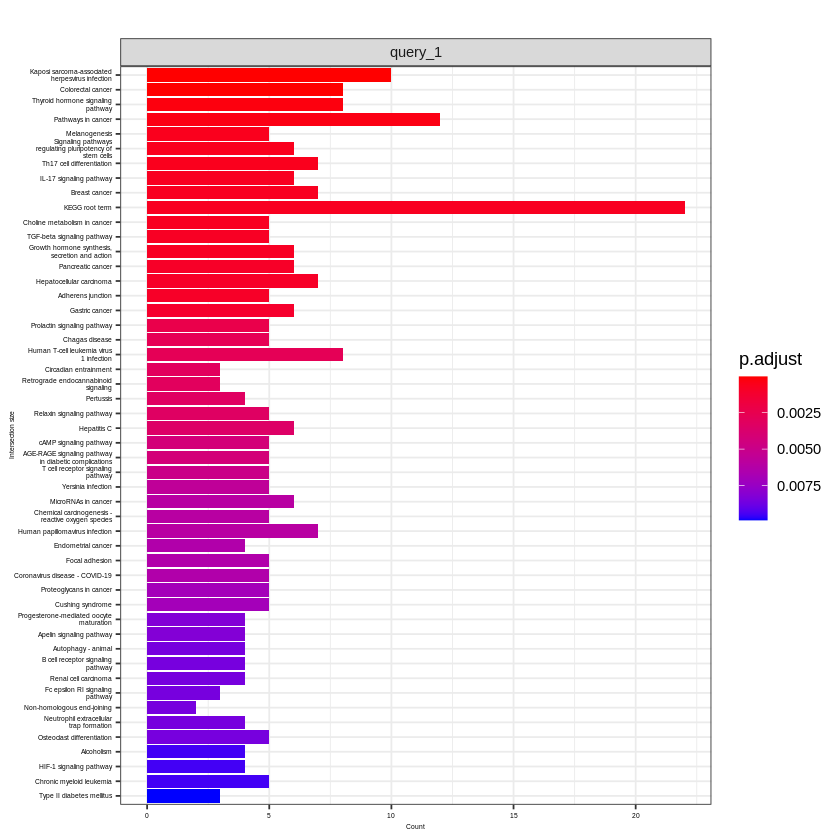

In [31]:

gp_mod = table_s9$result[table_s9$result[,'source']=='KEGG',c("query", "source", "term_id",
                                "term_name", "p_value", "query_size", 
                                "intersection_size", "term_size", 
                                "effective_domain_size", "intersection")]

gp_mod$GeneRatio = paste0(gp_mod$intersection_size,  "/", gp_mod$query_size)
gp_mod$BgRatio = paste0(gp_mod$term_size, "/", gp_mod$effective_domain_size)
names(gp_mod) = c("Cluster", "Category", "ID", "Description", "p.adjust", 
                    "query_size", "Count", "term_size", "effective_domain_size", 
                    "geneID", "GeneRatio", "BgRatio")
gp_mod$geneID = gsub(",", "/", gp_mod$geneID)
row.names(gp_mod) = gp_mod$ID

gp_mod_cluster = new("compareClusterResult", compareClusterResult = gp_mod)
gp_mod_enrich  = new("enrichResult", result = gp_mod)

enrichplot::dotplot(gp_mod_cluster,showCategory=50,font.size=4)

ggsave("dotplot_tableS9.svg", width = 20, height = 18, units = "cm")

barplot(gp_mod_enrich, showCategory = 50, font.size = 4) + 
  ggplot2::facet_grid(~Cluster) +
  ggplot2::ylab("Intersection size")

ggsave("barplot_tableS9.svg", width = 20, height = 18, units = "cm")

### Save Supplementary Table 9

In [32]:
write.table(as.matrix(table_s9$result),file = 'table_s9.tsv',sep='\t',col.names = T,row.names = F,quote = T)

## Functional Enrichment Analysis of Significantly central proteins of each cluster

#### Load Significantly central proteins

In [33]:
cluster_1_centrality <- read.table('../Protein_Significance_analysis/significant_proteins_cluster_1.txt',sep='\t',header=T)
cluster_2_centrality <- read.table('../Protein_Significance_analysis/significant_proteins_cluster_2.txt',sep='\t',header=T)
cluster_3_centrality <- read.table('../Protein_Significance_analysis/significant_proteins_cluster_3.txt',sep='\t',header=T)
cluster_4_centrality <- read.table('../Protein_Significance_analysis/significant_proteins_cluster_4.txt',sep='\t',header=T)
cluster_5_centrality <- read.table('../Protein_Significance_analysis/significant_proteins_cluster_5.txt',sep='\t',header=T)
cluster_6_centrality <- read.table('../Protein_Significance_analysis/significant_proteins_cluster_6.txt',sep='\t',header=T)
cluster_7_centrality <- read.table('../Protein_Significance_analysis/significant_proteins_cluster_7.txt',sep='\t',header=T)
cluster_8_centrality <- read.table('../Protein_Significance_analysis/significant_proteins_cluster_8.txt',sep='\t',header=T)

### Filter to betweeneess + degree p-value < 0.01

In [34]:
sign_central_1 <- cluster_1_centrality[cluster_1_centrality$pvalue_ratio < 0.01 & cluster_1_centrality$pvalue_degree < 0.01, ]$all_genes
sign_central_2 <- cluster_2_centrality[cluster_2_centrality$pvalue_ratio < 0.01 & cluster_2_centrality$pvalue_degree < 0.01, ]$all_genes
sign_central_3 <- cluster_3_centrality[cluster_3_centrality$pvalue_ratio < 0.01 & cluster_3_centrality$pvalue_degree < 0.01, ]$all_genes
sign_central_4 <- cluster_4_centrality[cluster_4_centrality$pvalue_ratio < 0.01 & cluster_4_centrality$pvalue_degree < 0.01, ]$all_genes
sign_central_5 <- cluster_5_centrality[cluster_5_centrality$pvalue_ratio < 0.01 & cluster_5_centrality$pvalue_degree < 0.01, ]$all_genes
sign_central_6 <- cluster_6_centrality[cluster_6_centrality$pvalue_ratio < 0.01 & cluster_6_centrality$pvalue_degree < 0.01, ]$all_genes
sign_central_7 <- cluster_7_centrality[cluster_7_centrality$pvalue_ratio < 0.01 & cluster_7_centrality$pvalue_degree < 0.01, ]$all_genes
sign_central_8 <- cluster_8_centrality[cluster_8_centrality$pvalue_ratio < 0.01 & cluster_8_centrality$pvalue_degree < 0.01, ]$all_genes

In [35]:
sign_central_8 <- sign_central_8[-4] #WE FILTER EP300 AS THE PRESENCE OF THE NODE WAS NOT ENRICHED.
sign_central_8

[1] "CDK6"   "CREBBP" "CTNNB1" "FOS"    "GSK3B"  "HDAC2"  "HDAC3"  "HIF1A" 
 [9] "JUND"   "KAT5"   "MAPK1"  "MAPK3"  "MAPK8"  "NCOR2"  "PGR"    "PIAS1" 
[17] "SMAD2"  "SMAD4"  "UBA52"  "UBE2I"  "XRCC5"  "XRCC6"

In [36]:
lista_sign <- list(sign_central_8,sign_central_7,sign_central_6,sign_central_5,sign_central_4,sign_central_3,sign_central_2,sign_central_1)
names(lista_sign) <- c('Cluster eight','Cluster seven','Cluster six','Cluster five','Cluster four','Cluster three','Cluster two','Cluster one')

In [37]:
table_full <- gprofiler2::gost(query = lista_sign,
                             organism = 'hsapiens',
                             ordered_query = F,
                             significant = T,
                             evcodes=T,
                             user_threshold = 0.05,
                             correction_method = "fdr",
                             domain_scope = 'custom',
                             custom_bg = intermediate_uni) 
#Only intermediate universe as background

# Dot plot for GO Biological Process

In [38]:
options(repr.plot.width=20, repr.plot.height=40)

Warning message in order(as.numeric(unique(result$Cluster))):
“NAs introduced by coercion”


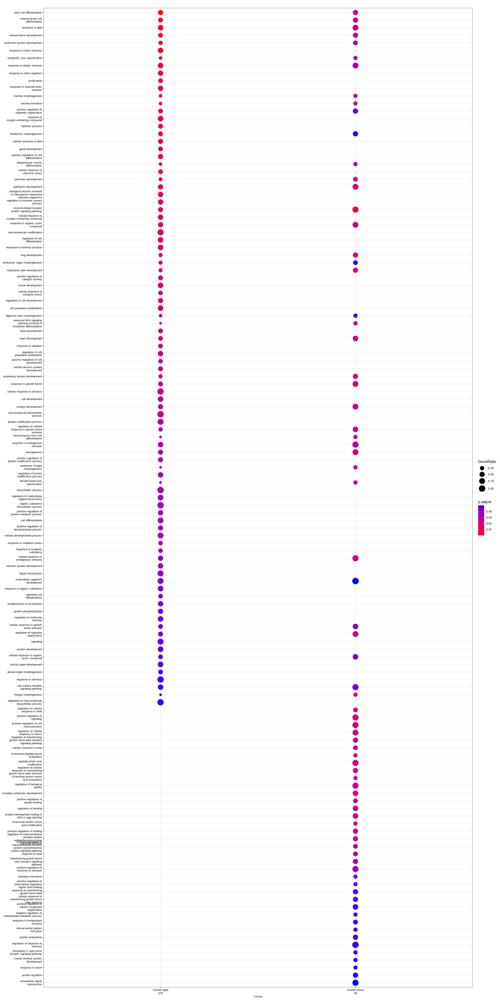

In [39]:
gp_mod = table_full$result[table_full$result[,'source']=='GO:BP',c("query", "source", "term_id",
                                "term_name", "p_value", "query_size", 
                                "intersection_size", "term_size", 
                                "effective_domain_size", "intersection")]

gp_mod$GeneRatio = paste0(gp_mod$intersection_size,  "/", gp_mod$query_size)
gp_mod$BgRatio = paste0(gp_mod$term_size, "/", gp_mod$effective_domain_size)
names(gp_mod) = c("Cluster", "Category", "ID", "Description", "p.adjust", 
                    "query_size", "Count", "term_size", "effective_domain_size", 
                    "geneID", "GeneRatio", "BgRatio")
gp_mod$geneID = gsub(",", "/", gp_mod$geneID)
#row.names(gp_mod) = gp_mod$ID

gp_mod_cluster = new("compareClusterResult", compareClusterResult = gp_mod)
gp_mod_enrich  = new("enrichResult", result = gp_mod)

ploto <- enrichplot:::dotplot.compareClusterResult(gp_mod_cluster,showCategory=75,font.size=8)

ploto

#ggsave("dotplot_tableS9.svg", width = 20, height = 90, units = "cm")

ggsave("dotplot_GOBP.pdf", width = 20, height = 90, units = "cm", dpi=300)

# Dot plot for GO Molecular Function

In [40]:
options(repr.plot.width=10, repr.plot.height=20)

Warning message in order(as.numeric(unique(result$Cluster))):
“NAs introduced by coercion”


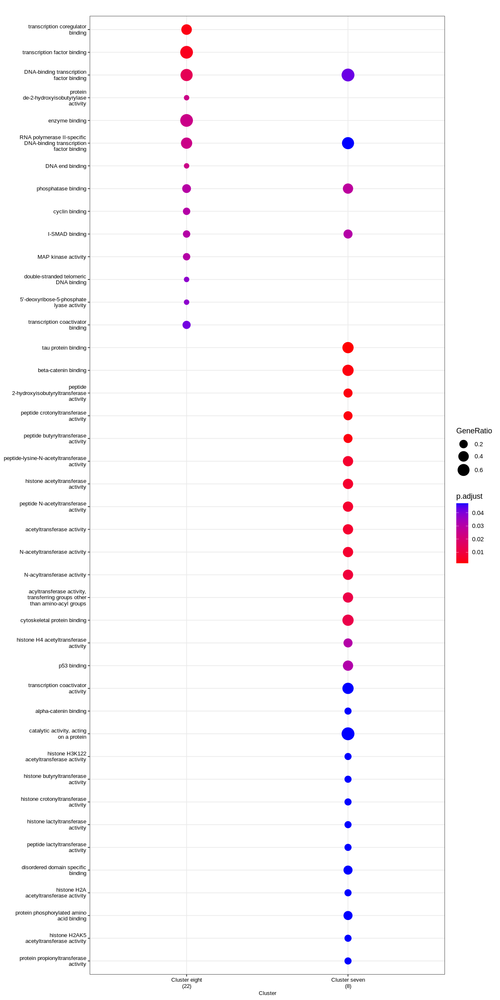

In [41]:
gp_mod = table_full$result[table_full$result[,'source']=='GO:MF',c("query", "source", "term_id",
                                "term_name", "p_value", "query_size", 
                                "intersection_size", "term_size", 
                                "effective_domain_size", "intersection")]

gp_mod$GeneRatio = paste0(gp_mod$intersection_size,  "/", gp_mod$query_size)
gp_mod$BgRatio = paste0(gp_mod$term_size, "/", gp_mod$effective_domain_size)
names(gp_mod) = c("Cluster", "Category", "ID", "Description", "p.adjust", 
                    "query_size", "Count", "term_size", "effective_domain_size", 
                    "geneID", "GeneRatio", "BgRatio")
gp_mod$geneID = gsub(",", "/", gp_mod$geneID)
#row.names(gp_mod) = gp_mod$ID

gp_mod_cluster = new("compareClusterResult", compareClusterResult = gp_mod)
gp_mod_enrich  = new("enrichResult", result = gp_mod)

ploto <- enrichplot:::dotplot.compareClusterResult(gp_mod_cluster,showCategory=75,font.size=8)

ploto

#ggsave("dotplot_tableS9.svg", width = 20, height = 90, units = "cm")

ggsave("dotplot_GOMF.pdf", width = 20, height = 90, units = "cm", dpi=300)

# Dot plot for GO Cellular Component

In [42]:
options(repr.plot.width=10, repr.plot.height=20)

Warning message in order(as.numeric(unique(result$Cluster))):
“NAs introduced by coercion”


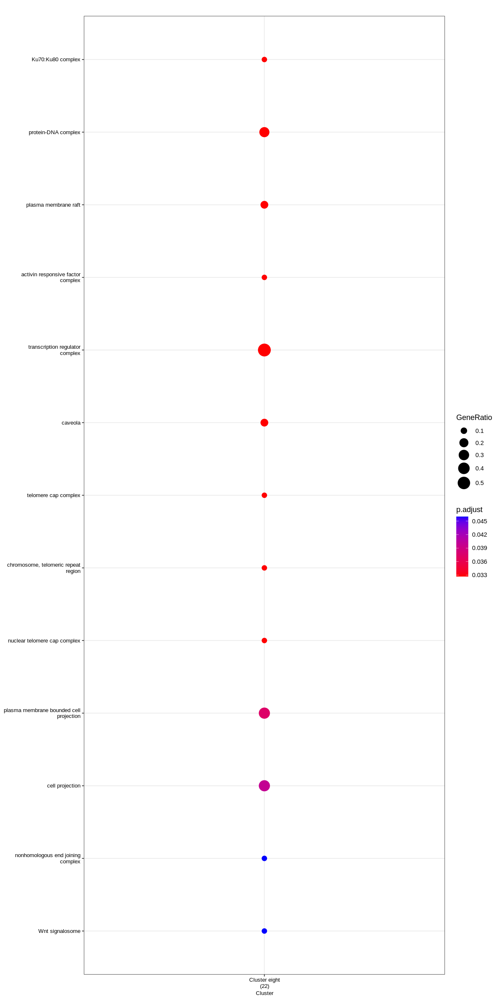

In [43]:
gp_mod = table_full$result[table_full$result[,'source']=='GO:CC',c("query", "source", "term_id",
                                "term_name", "p_value", "query_size", 
                                "intersection_size", "term_size", 
                                "effective_domain_size", "intersection")]

gp_mod$GeneRatio = paste0(gp_mod$intersection_size,  "/", gp_mod$query_size)
gp_mod$BgRatio = paste0(gp_mod$term_size, "/", gp_mod$effective_domain_size)
names(gp_mod) = c("Cluster", "Category", "ID", "Description", "p.adjust", 
                    "query_size", "Count", "term_size", "effective_domain_size", 
                    "geneID", "GeneRatio", "BgRatio")
gp_mod$geneID = gsub(",", "/", gp_mod$geneID)
#row.names(gp_mod) = gp_mod$ID

gp_mod_cluster = new("compareClusterResult", compareClusterResult = gp_mod)
gp_mod_enrich  = new("enrichResult", result = gp_mod)

ploto <- enrichplot:::dotplot.compareClusterResult(gp_mod_cluster,showCategory=75,font.size=8)

ploto

#ggsave("dotplot_tableS9.svg", width = 20, height = 90, units = "cm")

ggsave("dotplot_GOCC.pdf", width = 20, height = 90, units = "cm", dpi=300)

# Dot plot for KEGG

In [44]:
options(repr.plot.width=20, repr.plot.height=40)

Warning message in order(as.numeric(unique(result$Cluster))):
“NAs introduced by coercion”


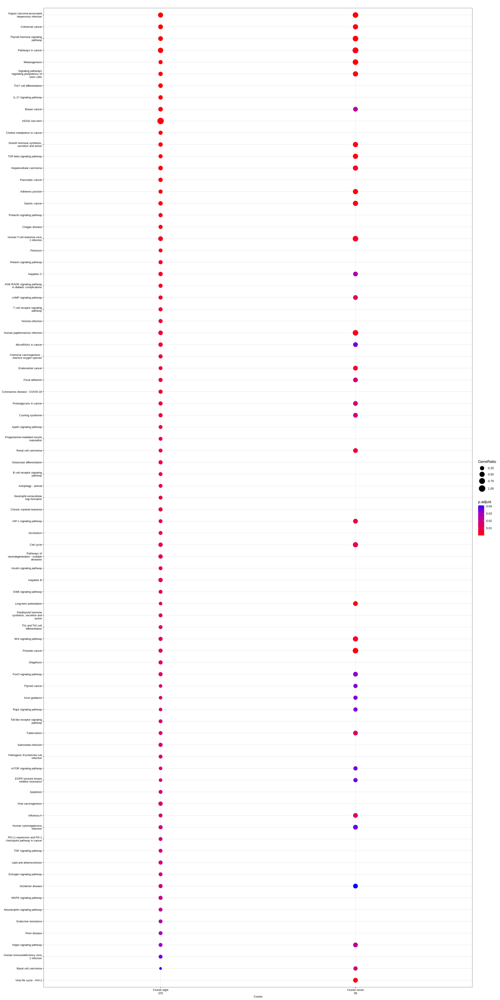

In [45]:
gp_mod = table_full$result[table_full$result[,'source']=='KEGG',c("query", "source", "term_id",
                                "term_name", "p_value", "query_size", 
                                "intersection_size", "term_size", 
                                "effective_domain_size", "intersection")]

gp_mod$GeneRatio = paste0(gp_mod$intersection_size,  "/", gp_mod$query_size)
gp_mod$BgRatio = paste0(gp_mod$term_size, "/", gp_mod$effective_domain_size)
names(gp_mod) = c("Cluster", "Category", "ID", "Description", "p.adjust", 
                    "query_size", "Count", "term_size", "effective_domain_size", 
                    "geneID", "GeneRatio", "BgRatio")
gp_mod$geneID = gsub(",", "/", gp_mod$geneID)
#row.names(gp_mod) = gp_mod$ID

gp_mod_cluster = new("compareClusterResult", compareClusterResult = gp_mod)
gp_mod_enrich  = new("enrichResult", result = gp_mod)

ploto <- enrichplot:::dotplot.compareClusterResult(gp_mod_cluster,showCategory=75,font.size=8)

ploto

#ggsave("dotplot_tableS9.svg", width = 20, height = 90, units = "cm")

ggsave("dotplot_KEGG.pdf", width = 20, height = 90, units = "cm", dpi=300)

# Dot plot for Reactome

In [46]:
options(repr.plot.width=20, repr.plot.height=40)

Warning message in order(as.numeric(unique(result$Cluster))):
“NAs introduced by coercion”


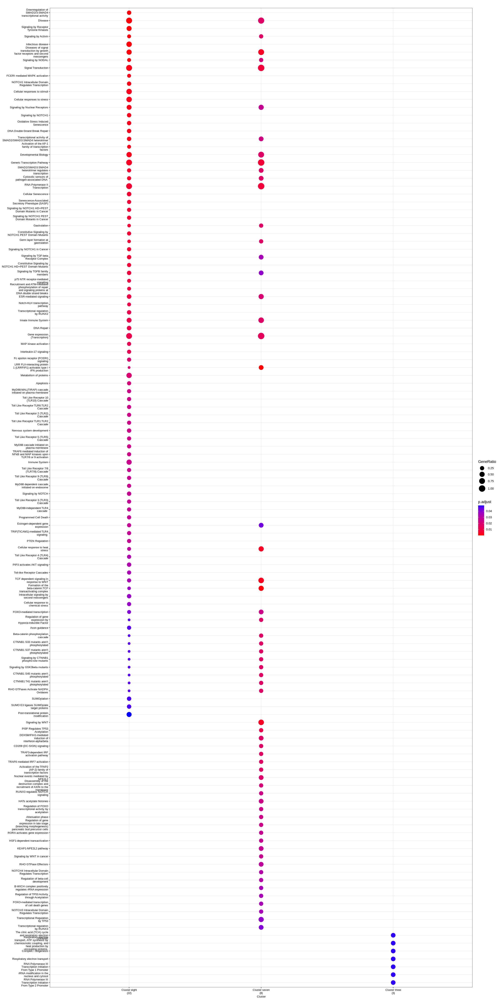

In [47]:
gp_mod = table_full$result[table_full$result[,'source']=='REAC',c("query", "source", "term_id",
                                "term_name", "p_value", "query_size", 
                                "intersection_size", "term_size", 
                                "effective_domain_size", "intersection")]

gp_mod$GeneRatio = paste0(gp_mod$intersection_size,  "/", gp_mod$query_size)
gp_mod$BgRatio = paste0(gp_mod$term_size, "/", gp_mod$effective_domain_size)
names(gp_mod) = c("Cluster", "Category", "ID", "Description", "p.adjust", 
                    "query_size", "Count", "term_size", "effective_domain_size", 
                    "geneID", "GeneRatio", "BgRatio")
gp_mod$geneID = gsub(",", "/", gp_mod$geneID)
#row.names(gp_mod) = gp_mod$ID

gp_mod_cluster = new("compareClusterResult", compareClusterResult = gp_mod)
gp_mod_enrich  = new("enrichResult", result = gp_mod)

ploto <- enrichplot:::dotplot.compareClusterResult(gp_mod_cluster,showCategory=75,font.size=8)

ploto

#ggsave("dotplot_tableS9.svg", width = 20, height = 90, units = "cm")

ggsave("dotplot_Reactome.pdf", width = 20, height = 90, units = "cm", dpi=300)

# Dot plot for Wikipathways

In [48]:
options(repr.plot.width=20, repr.plot.height=40)

Warning message in order(as.numeric(unique(result$Cluster))):
“NAs introduced by coercion”


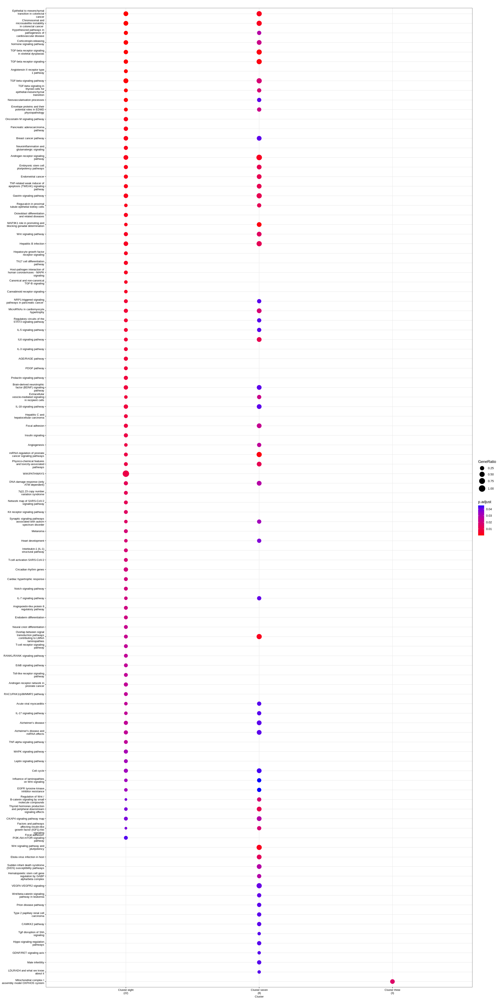

In [49]:
gp_mod = table_full$result[table_full$result[,'source']=='WP',c("query", "source", "term_id",
                                "term_name", "p_value", "query_size", 
                                "intersection_size", "term_size", 
                                "effective_domain_size", "intersection")]

gp_mod$GeneRatio = paste0(gp_mod$intersection_size,  "/", gp_mod$query_size)
gp_mod$BgRatio = paste0(gp_mod$term_size, "/", gp_mod$effective_domain_size)
names(gp_mod) = c("Cluster", "Category", "ID", "Description", "p.adjust", 
                    "query_size", "Count", "term_size", "effective_domain_size", 
                    "geneID", "GeneRatio", "BgRatio")
gp_mod$geneID = gsub(",", "/", gp_mod$geneID)
#row.names(gp_mod) = gp_mod$ID

gp_mod_cluster = new("compareClusterResult", compareClusterResult = gp_mod)
gp_mod_enrich  = new("enrichResult", result = gp_mod)

ploto <- enrichplot:::dotplot.compareClusterResult(gp_mod_cluster,showCategory=75,font.size=8)

ploto

#ggsave("dotplot_tableS9.svg", width = 20, height = 90, units = "cm")

ggsave("dotplot_WP.pdf", width = 20, height = 90, units = "cm", dpi=300)